## Action Space

- {'steering_angle': -30, 'speed': 0.6},
- {'steering_angle': -15, 'speed': 0.6},
- {'steering_angle': 0, 'speed': 0.6},
- {'steering_angle': 15, 'speed': 0.6},
- {'steering_angle': 30, 'speed': 0.6}

Can be found in "/opt/ml/code/custom_files/agent/model_metadata.json"

In [1]:
import skimage
import sys
sys.path += ['../Disparity_Map_Stereo_Vision']

import numpy as np 
import cv2
import math
import Disparity as dis
import host_code
import matplotlib.pyplot as plt

from skimage.filters import threshold_multiotsu

In [2]:
def get_otsu(img, classes=3):
    thresholds = threshold_multiotsu(img, classes=classes)
    return np.digitize(img, bins=thresholds)*127

def get_disparity(left, right):
    # Pre-processing by mean adjusting the images
    L_gray = left - np.mean(left)
    R_gray = right - np.mean(right)

    # Select block size over here 
    block_size = [11, 11]

    # Call to GPU function
    D_map = host_code.compute_disparity_gpu(L_gray, R_gray, block_size)

    # Smoothening the result by passing it through a median filter
    return cv2.medianBlur(D_map, 13)

<IPython.core.display.Javascript object>


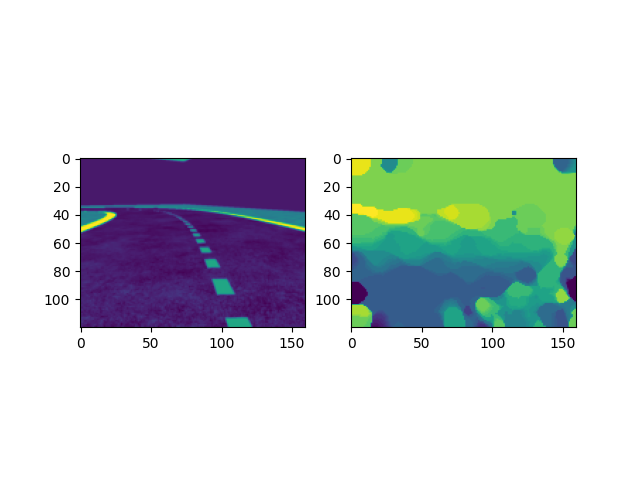

In [34]:
fig, axs = plt.subplots(ncols=2)

img = cv2.imread('data/left_0400.png', cv2.IMREAD_GRAYSCALE)

# Applying multi-Otsu threshold for the default value, generating
# three classes.
thresholds = threshold_multiotsu(img, classes=3)

# Using the threshold values, we generate the three regions.
regions = np.digitize(img, bins=thresholds)

axs[0].imshow(img)
axs[1].imshow(regions)

### Imports

In [3]:
from stable_baselines3 import A2C, PPO, DQN

import utils
import deepracer_gym
import matplotlib.pyplot as plt
import cv2
import numpy as np
import gym

import sys
sys.path.append('..')

from agents.deepracer_base_agent import DeepracerAgent

from stable_baselines3.common.torch_layers import BaseFeaturesExtractor
from stable_baselines3.common.vec_env import DummyVecEnv, VecTransposeImage, SubprocVecEnv, VecEnvWrapper, VecEnv
from stable_baselines3.common.vec_env.base_vec_env import VecEnv, VecEnvStepReturn, VecEnvWrapper
from stable_baselines3.common.vec_env import VecExtractDictObs
from stable_baselines3.common.monitor import Monitor

from torch.nn import Linear, ReLU, CrossEntropyLoss, Sequential, Conv2d, MaxPool2d, Module, Softmax, BatchNorm2d, Dropout
from torch.optim import Adam, SGD

from utils import *
%matplotlib notebook

In [21]:
left = cv2.imread('data/left_0400.png', cv2.IMREAD_GRAYSCALE)
right = cv2.imread('data/right_0400.png', cv2.IMREAD_GRAYSCALE)
img = np.stack((left, right), axis=-1)

In [4]:
from stable_baselines3.common.type_aliases import GymObs, GymStepReturn
from typing import Dict, List, Optional, Tuple, Union
from skimage.transform import resize

class ImageWrap(gym.Wrapper):
    """
    A monitor wrapper for Gym environments, it is used to know the episode reward, length, time and other data.

    :param env: The environment
    :param filename: the location to save a log file, can be None for no log
    :param allow_early_resets: allows the reset of the environment before it is done
    :param reset_keywords: extra keywords for the reset call,
        if extra parameters are needed at reset
    :param info_keywords: extra information to log, from the information return of env.step()
    """


    def __init__(
        self,
        env: gym.Env,
        size: Tuple[int,int] = (64,64),
        disparity: bool = False
    ):
        super(ImageWrap, self).__init__(env=env)
        self.size = size
        self.disparity = disparity
        self.observation_space = gym.spaces.Box(low=0,high=255,shape=size+(5 if disparity else 4,), dtype='uint8')

    def transform_img(self,obs,disparity=False):

        # resize and get individual
        obs = cv2.resize(obs, dsize=self.size, interpolation=cv2.INTER_CUBIC)
        left, right = obs[:,:,0], obs[:,:,1]
        
        # compute otsu thresholding
        left_t = get_otsu(left)
        right_t = get_otsu(right)

        imgs = (left, right, left_t, right_t)
        
        if disparity:
            # compute disparity
            disparity = get_disparity(left,right)
            imgs += (disparity,)
        
        return np.stack(imgs,axis=-1)
    
    def reset(self, **kwargs) -> GymObs:
        """
        Calls the Gym environment reset. Can only be called if the environment is over, or if allow_early_resets is True

        :param kwargs: Extra keywords saved for the next episode. only if defined by reset_keywords
        :return: the first observation of the environment
        """
        obs = self.env.reset(**kwargs)
        obs = obs['STEREO_CAMERAS']
        
        return self.transform_img(obs, disparity=self.disparity)


    def step(self, action: Union[np.ndarray, int]) -> GymStepReturn:
        """
        Step the environment with the given action

        :param action: the action
        :return: observation, reward, done, information
        """
        observation, reward, done, info = self.env.step(action)
        obs = self.transform_img(observation['STEREO_CAMERAS'], disparity=self.disparity)
        
        return obs, reward, done, info

# A2C

## Extract Features from dict

In [2]:
import torch.nn as nn

class BasicExtractor(BaseFeaturesExtractor):
    """
    :param observation_space: (gym.Space)
    :param features_dim: (int) Number of features extracted.
        This corresponds to the number of unit for the last layer.
    """

    def __init__(self, observation_space, features_dim = 128, num_envs=1, **kwargs):
        super(BasicExtractor, self).__init__(observation_space, features_dim)
        
        self.linear = nn.Sequential(
            Conv2d(1, 16, kernel_size=3, stride=1, padding=1),
            BatchNorm2d(16),
            ReLU(inplace=True),
            MaxPool2d(kernel_size=2, stride=2),

            Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            BatchNorm2d(32),
            ReLU(inplace=True),
            MaxPool2d(kernel_size=2, stride=2),

            nn.ReLU(),
            nn.Flatten(),
            nn.Linear(512,128)
        ).to('cuda:0').float()
        self.num_envs = num_envs
        
    def forward(self, observations,  **kwargs):
        inp = tensor_to_features(observations[:,1:,:,:]).float()
        return self.linear(inp)
    
    
policy_kwargs = dict(
    features_extractor_class=BasicExtractor,
    features_extractor_kwargs=dict(features_dim=128, num_envs=1),
)


In [5]:
def linear_schedule(initial_value: float) :
    """
    Linear learning rate schedule.

    :param initial_value: Initial learning rate.
    :return: schedule that computes
      current learning rate depending on remaining progress
    """
    def func(progress_remaining: float) -> float:
        """
        Progress will decrease from 1 (beginning) to 0.

        :param progress_remaining:
        :return: current learning rate
        """
        return progress_remaining * initial_value

    return func


## Create Environment

In [6]:
torch.set_default_dtype(torch.float32)

In [7]:
from stable_baselines3.common.callbacks import CheckpointCallback

start_env = lambda port : lambda: Monitor(ImageWrap(gym.make('deepracer_gym:deepracer-v0', port=port)))

env = DummyVecEnv([start_env(8888), start_env(8889)])

checkpoint_callback = CheckpointCallback(save_freq=50_000, save_path='./logs/',
                                         name_prefix='1M_model')

# model = PPO.load('1M8model',
#                  env=env,
#                  learning_rate=1e-4,
#                  tensorboard_log="./a2c_new/",
#                  device='cuda:0')
#model = PPO('CnnPolicy', env=env, learning_rate=3e-4,tensorboard_log='./a2c_new/', device='cuda:0', verbose=10)

In [12]:
model = PPO.load('not_bad',
                 env=env,
                 learning_rate=linear_schedule(1e-4),
                 tensorboard_log="./a2c_new/",
                 device='cuda:0')

Wrapping the env in a VecTransposeImage.


In [ ]:
model.learn(total_timesteps=600_000, callback=checkpoint_callback)

Logging to ./a2c_new/PPO_16
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 472      |
|    ep_rew_mean     | 468      |
| time/              |          |
|    fps             | 10       |
|    iterations      | 1        |
|    time_elapsed    | 379      |
|    total_timesteps | 4096     |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 502         |
|    ep_rew_mean          | 495         |
| time/                   |             |
|    fps                  | 9           |
|    iterations           | 2           |
|    time_elapsed         | 833         |
|    total_timesteps      | 8192        |
| train/                  |             |
|    approx_kl            | 0.032603167 |
|    clip_fraction        | 0.0973      |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.207      |
|    explained_variance   | -0.0319     |
| 

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 521         |
|    ep_rew_mean          | 512         |
| time/                   |             |
|    fps                  | 9           |
|    iterations           | 11          |
|    time_elapsed         | 4738        |
|    total_timesteps      | 45056       |
| train/                  |             |
|    approx_kl            | 0.027128384 |
|    clip_fraction        | 0.101       |
|    clip_range           | 0.2         |
|    entropy_loss         | -0.213      |
|    explained_variance   | -0.0803     |
|    learning_rate        | 9.32e-05    |
|    loss                 | 4.11        |
|    n_updates            | 1810        |
|    policy_gradient_loss | 0.00325     |
|    value_loss           | 75.4        |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 522   

In [135]:
# resize and get individual
obs = cv2.resize(img, dsize=(64, 64), interpolation=cv2.INTER_CUBIC)
left, right = obs[:,:,0], obs[:,:,1]

# compute otsu thresholding
left_t = get_otsu(left)
right_t = get_otsu(right)

# compute disparity
disparity = get_disparity(left,right)

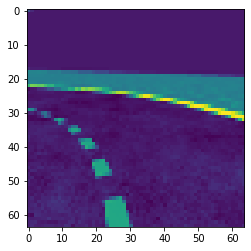

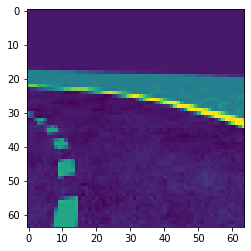

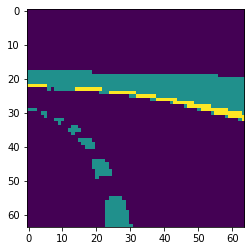

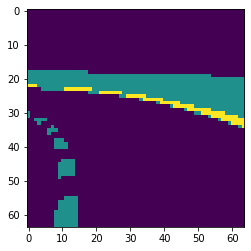

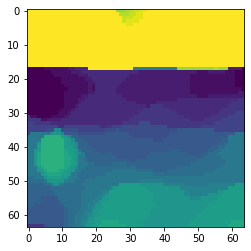

In [136]:
plt.imshow(left)
plt.show()
plt.imshow(right)
plt.show()
plt.imshow(left_t)
plt.show()
plt.imshow(right_t)
plt.show()
plt.imshow(disparity)
plt.show()

In [92]:
%matplotlib inline

In [89]:
np.stack((np.array([1,2,3]),np.array([1,2,3]))).shape

(2, 3)

In [62]:
from pytorch_grad_cam import GradCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
from torchvision.models import resnet50

vizs2 = []

cam = GradCAM(model=model.policy.features_extractor, target_layer=model.policy.features_extractor.cnn[0], use_cuda=True)

for i in range(len(saved_obs)):

    test_img = torch.tensor(saved_obs[i][1:]/255, device='cuda').float()

    # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
    grayscale_cam = cam(input_tensor=test_img)

    # In this example grayscale_cam has only one image in the batch:
    grayscale_cam = grayscale_cam[0, :]
    visualization = show_cam_on_image(np.float32(saved_obs[i][0,0])[:,:,None]/255, grayscale_cam, use_rgb=True)

    vizs2 += [visualization]


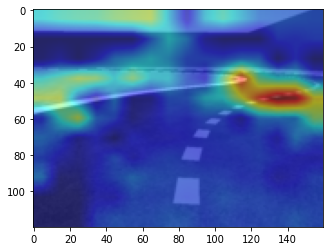

In [69]:
plt.imshow(vizs[528])

In [31]:
np.float32(saved_obs[i][0,0])

(120, 160)

In [81]:
np.float32(ag.rollout_buffer.observations[0,0]/255).shape

(120, 160)

In [73]:
show_cam_on_image?

### Render some episodes

In [17]:
from tqdm.notebook import tqdm

In [18]:
saved_obs  = []
saved_acts = []

obs = env.reset()

for i in tqdm(range(5000)):
    action, _state = model.predict(obs, deterministic=True)
    obs, reward, done, info = env.step(action)
    
    if i%5 == 0:
        saved_obs.append(obs)
        saved_acts.append(action)

    if done[0]:
      obs = env.reset()

100%|██████████| 5000/5000 [14:21<00:00,  5.80it/s]


In [13]:
saved_acts

[array([2, 3]),
 array([2, 2]),
 array([2, 3]),
 array([2, 3]),
 array([2, 2]),
 array([2, 2]),
 array([1, 1]),
 array([3, 2]),
 array([1, 2]),
 array([1, 2]),
 array([2, 2]),
 array([2, 2]),
 array([3, 2]),
 array([1, 1]),
 array([2, 3]),
 array([2, 3]),
 array([3, 3]),
 array([4, 1]),
 array([2, 1]),
 array([2, 2]),
 array([2, 2]),
 array([2, 1]),
 array([2, 1]),
 array([2, 2]),
 array([2, 3]),
 array([2, 2]),
 array([3, 4]),
 array([2, 2]),
 array([2, 0]),
 array([2, 3]),
 array([2, 2]),
 array([2, 2]),
 array([3, 4]),
 array([3, 4]),
 array([2, 2]),
 array([2, 2]),
 array([0, 3]),
 array([4, 3]),
 array([4, 3]),
 array([1, 2]),
 array([4, 2]),
 array([2, 4]),
 array([4, 2]),
 array([4, 0]),
 array([2, 2]),
 array([2, 2]),
 array([2, 2]),
 array([4, 2]),
 array([4, 4]),
 array([2, 3]),
 array([1, 2]),
 array([2, 2]),
 array([0, 0]),
 array([0, 0]),
 array([3, 0]),
 array([2, 2]),
 array([1, 2]),
 array([2, 2]),
 array([1, 1]),
 array([0, 1]),
 array([3, 2]),
 array([4, 2]),
 array([

### Add action selected on top of images

In [17]:
saved_obs[0].shape

(2, 2, 120, 160)

In [18]:
font                   = cv2.FONT_HERSHEY_SIMPLEX
bottomLeftCornerOfText = (10,25)
fontScale              = 1
fontColor              = (255)
lineType               = 2


add_text = lambda img,txt: cv2.putText(img.astype('float'),txt, 
    bottomLeftCornerOfText, 
    font, 
    fontScale,
    fontColor,
    lineType)


real_obs = [add_text(img[0,0], str(txt[0])) for img,txt in zip(saved_obs, saved_acts)]

## Animate

In [71]:
%%capture
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml"

fig, ax = plt.subplots()

ims = []
for i, obs in enumerate(vizs2):
    im = ax.imshow(obs, animated=True)
    if i == 0:
        ax.imshow(obs)  # show an initial one first
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=100, blit=True,
                                repeat_delay=1000)

In [72]:
ani

Animation size has reached 21011667 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
f = "oof.gif" 
writergif = animation.PillowWriter(fps=10) 
ani.save(f, writer=writergif)

In [58]:
import torch

In [59]:
torch.tensor(saved_obs[0])

tensor([[[[ 74,  74,  74,  ...,  74,  74,  74],
          [ 74,  74,  74,  ...,  74,  74,  74],
          [ 74,  74,  74,  ...,  74,  74,  74],
          ...,
          [ 79,  78,  73,  ..., 255, 255, 255],
          [ 75,  74,  72,  ..., 255, 255, 255],
          [ 68,  77,  72,  ..., 255, 255, 255]],

         [[ 74,  74,  74,  ...,  74,  74,  74],
          [ 74,  74,  74,  ...,  74,  74,  74],
          [ 74,  74,  74,  ...,  74,  74,  74],
          ...,
          [ 74,  70,  72,  ..., 147, 142, 145],
          [ 70,  65,  73,  ..., 163, 152, 149],
          [ 67,  66,  70,  ..., 180, 153, 137]]]], dtype=torch.uint8)

In [51]:
ani

## Unused for now

In [60]:
env = gym.make('deepracer_gym:deepracer-v0',  port=8889)

obs = env.reset()

print("Deepracer Environment Connected succesfully")

steps_completed = 0
episodes_completed = 0
total_reward = 0
rewards = []
saved_obs = []

while episodes_completed < 1:

    # init
    if '_next_state' in obs:
        observation = obs['_next_state']
        info = {}

    print(observation)
    # let agent select next state
    #action = agent.decide(observation)


    # step in action
    observation, reward, done, info = env.step(0)
    steps_completed += 1
    total_reward += reward

    # store information for training
    #agent.observe(observation, action, reward)

    # episode completion
    if done:
        episodes_completed += 1
        print("Episodes Completed:", episodes_completed,
              "Steps:", steps_completed, "Reward", total_reward)
        steps_completed = 0
        rewards.append(total_reward)
        total_reward = 0
        #agent.train()

Deepracer Environment Connected succesfully
{'STEREO_CAMERAS': array([[[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74,  74]],

       [[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74,  74]],

       [[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74,  74]],

       ...,

       [[166, 146],
        [168, 162],
        [165, 160],
        ...,
        [129, 164],
        [133, 159],
        [142, 157]],

       [[171, 158],
        [180, 172],
        [178, 163],
        ...,
        [148, 149],
        [142, 148],
        [133, 144]],

       [[175, 167],
        [178, 164],
        [167, 150],
        ...,
        [142, 149],
        [137, 141],
        [136, 146]]], dtype=uint8)}
{'STEREO_CAMERAS': array([[[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        

{'STEREO_CAMERAS': array([[[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74,  74]],

       [[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74,  74]],

       [[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74,  74]],

       ...,

       [[166, 146],
        [168, 162],
        [165, 160],
        ...,
        [129, 164],
        [133, 159],
        [142, 157]],

       [[171, 158],
        [180, 172],
        [178, 163],
        ...,
        [148, 149],
        [142, 148],
        [133, 144]],

       [[175, 167],
        [178, 164],
        [167, 150],
        ...,
        [142, 149],
        [137, 141],
        [136, 146]]], dtype=uint8)}
{'STEREO_CAMERAS': array([[[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74

{'STEREO_CAMERAS': array([[[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74,  74]],

       [[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74,  74]],

       [[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74,  74]],

       ...,

       [[166, 146],
        [168, 162],
        [165, 160],
        ...,
        [129, 164],
        [133, 159],
        [142, 157]],

       [[171, 158],
        [180, 172],
        [178, 163],
        ...,
        [148, 149],
        [142, 148],
        [133, 144]],

       [[175, 167],
        [178, 164],
        [167, 150],
        ...,
        [142, 149],
        [137, 141],
        [136, 146]]], dtype=uint8)}
{'STEREO_CAMERAS': array([[[ 74,  74],
        [ 74,  74],
        [ 74,  74],
        ...,
        [ 74,  74],
        [ 74,  74],
        [ 74

In [51]:
from stable_baselines3.common.policies import ActorCriticCnnPolicy
from typing import Callable

def linear_schedule(initial_value: float) -> Callable[[float], float]:
    """
    Linear learning rate schedule.

    :param initial_value: Initial learning rate.
    :return: schedule that computes
      current learning rate depending on remaining progress
    """
    def func(progress_remaining: float) -> float:
        """
        Progress will decrease from 1 (beginning) to 0.

        :param progress_remaining:
        :return: current learning rate
        """
        return progress_remaining * initial_value

    return func

act_space = gym.spaces.Discrete(5)
obs_space = gym.spaces.Box(low=0, high=255, shape=(1,16,16), dtype=np.uint8)
schedule = linear_schedule(0.001)

#policy = ActorCriticCnnPolicy(obs_space, act_space, schedule, use_sde=False,**policy_kwargs)

In [66]:
observation['STEREO_CAMERAS'].shape

(120, 160, 2)

In [ ]:
{'STEREO_CAMERAS': (120,160,2), dtype='uint8'}

In [2]:
class BasicAgent(DeepracerAgent):
    def __init__(self, gamma=0.99, policy_learning_rate=0.002, value_learning_rate=0.002):

        self.plr = policy_learning_rate
        self.vlr = value_learning_rate
        self.gamma = gamma

        self.actions_prob = []
        self.saved_rewards = []
        self.model = None
        self.value_model = None
        self.n_moving_avg = 5

        # These lists stores the cumulative observations for this episode
        self.episode_observations, self.episode_actions, self.episode_rewards = [], [], []

        # Build the keras network
        self._build_network()

    def _convert_obs(self, observation):
        return segment_resize(observation['STEREO_CAMERAS'][:, :, 0])

    def observe(self, state, action, reward):
        """ This function takes the observations the agent received from the environment and stores them
            in the lists above."""
        self.episode_observations.append(
            self._convert_obs(state)[:, :, np.newaxis])
        self.episode_actions.append(action)
        self.episode_rewards.append(reward)

    def decide(self, state):
        """ This function feeds the observed state to the network, which returns a distribution
            over possible actions. Sample an action from the distribution and return it."""

        probs = np.ravel(self.model(self._convert_obs(state)
                         [np.newaxis, :, :, np.newaxis]))
        return np.random.choice(len(probs), p=probs)

    def register_reset(self, observations):
        action = np.random.randint(5)
        return action

    def compute_action(self, observations, info):
        action = np.random.randint(5)
        return action

    def train(self):
        """ When this function is called, the accumulated episode observations, actions and discounted rewards
            should be fed into the network and used for training. Use the _get_returns function to first turn 
            the episode rewards into discounted returns. 
            Apply simple or adaptive baselines if needed, depending on parameters."""

        states = np.stack(self.episode_observations)
        discounted = self._get_returns().reshape((-1, 1))

        # compute baseline and train
        baseline = self.value_model.predict_on_batch(states)
        self.value_model.train_on_batch(states, discounted.reshape((-1, 1)))

        # compute discounted rewards and remove baseline
        discounted_rewards = discounted - baseline

        # train model
        self.model.train_on_batch(
            states,
            tf.keras.utils.to_categorical(self.episode_actions, num_classes=5),
            sample_weight=discounted_rewards
        )
        # reset observations for next episode
        self.episode_observations, self.episode_actions, self.episode_rewards = [], [], []

    def moving_average(self, discounted):
        # save the mean of the rewards for the moving average
        self.saved_rewards.append(np.mean(discounted))
        # only keep last n averages
        if len(self.saved_rewards) > self.n_moving_avg:
            self.saved_rewards = self.saved_rewards[1:]
        # compute baseline from the moving average
        return np.mean(self.saved_rewards)

    def _get_returns(self):
        """ This function should process self.episode_rewards and return the discounted episode returns
            at each step in the episode. Hint: work backwards."""

        discounted_rewards = []
        cumulative_total_return = 0
        # iterate the rewards backwards and and calc the total return
        for reward in self.episode_rewards[::-1]:
            cumulative_total_return = (
                cumulative_total_return*self.gamma)+reward
            discounted_rewards.append(cumulative_total_return)
        # reverse sequence
        discounted_rewards.reverse()
        # convert to numpy array
        return np.array(discounted_rewards)

    def _build_network(self):
        """ This function should build the network that can then be called by decide and train. 
            The network takes observations as inputs and has a policy distribution as output."""

        model = Sequential()
        model.add(Conv2D(32, (3, 3), activation='relu',
                  kernel_initializer='he_uniform', input_shape=(16, 16, 1)))
        model.add(MaxPooling2D((2, 2)))
        model.add(Flatten())
        model.add(Dense(20, activation='relu', kernel_initializer='he_uniform'))
        model.add(Dense(5, activation='softmax'))
        model.compile(loss="categorical_crossentropy",
                      optimizer=Adam(learning_rate=self.plr))

        value_model = Sequential()
        value_model.add(Conv2D(32, (3, 3), activation='relu',
                        kernel_initializer='he_uniform', input_shape=(16, 16, 1)))
        value_model.add(MaxPooling2D((2, 2)))
        value_model.add(Flatten())
        value_model.add(Dense(20, activation='relu',
                        kernel_initializer='he_uniform'))
        value_model.add(Dense(1, activation='softmax'))
        value_model.compile(loss='mean_squared_error',
                            optimizer=Adam(learning_rate=self.vlr))

        self.model = model
        self.value_model = value_model

ModuleNotFoundError: No module named 'agents'